# Import

Commençons par importer les différentes librairies.

In [1]:
import mlflow
import mlflow.sklearn
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [2]:
import numpy as np
import pandas as pd 
from sklearn.preprocessing import LabelEncoder
import os
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
# Chemin vers le dossier
print(os.listdir("/Users/gregoirehamy/Desktop/OpenClassrooms/Projet7/Projet+Mise+en+prod+-+home-credit-default-risk"))

['application_test.csv', 'HomeCredit_columns_description.csv', 'POS_CASH_balance.csv', 'credit_card_balance.csv', 'installments_payments.csv', 'application_train.csv', 'bureau.csv', 'previous_application.csv', 'bureau_balance.csv', 'sample_submission.csv']


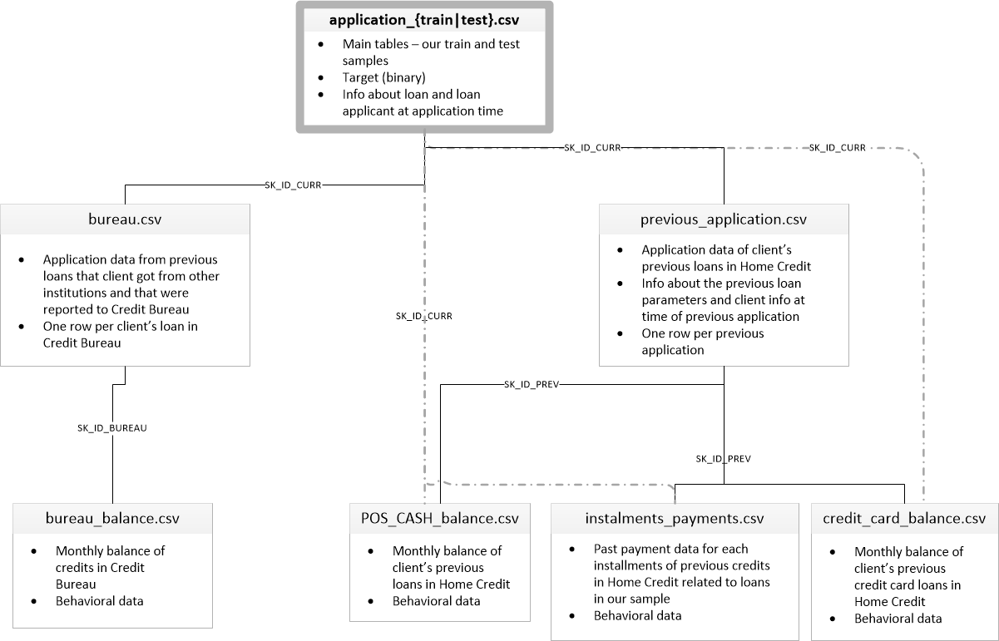

In [4]:
# Données d'entrainement
app_train = pd.read_csv('/Users/gregoirehamy/Desktop/OpenClassrooms/Projet7/Projet+Mise+en+prod+-+home-credit-default-risk/application_train.csv')
print('Training data shape: ', app_train.shape)
app_train.head()

Training data shape:  (307511, 122)


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
# Données de test
app_test = pd.read_csv('/Users/gregoirehamy/Desktop/OpenClassrooms/Projet7/Projet+Mise+en+prod+-+home-credit-default-risk/application_test.csv')
print('Testing data shape: ', app_test.shape)
app_test.head()

Testing data shape:  (48744, 121)


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


# Analyse exploratoire

Dans un premier temps, nous allons analyser notre jeu de données afin de mieux l'appréhender.

## Analyse de la distribution de la variable "Target"

Nous avons une variable "target" qui représente la variable cible à déterminer. Il s'agit de savoir si le client est en capacité de rembourser son prêt.

In [6]:
app_train['TARGET'].value_counts()

TARGET
0    282686
1     24825
Name: count, dtype: int64

282686 ne sont pas en capacité de rembourser leur prêt contre 24825

<Axes: ylabel='Frequency'>

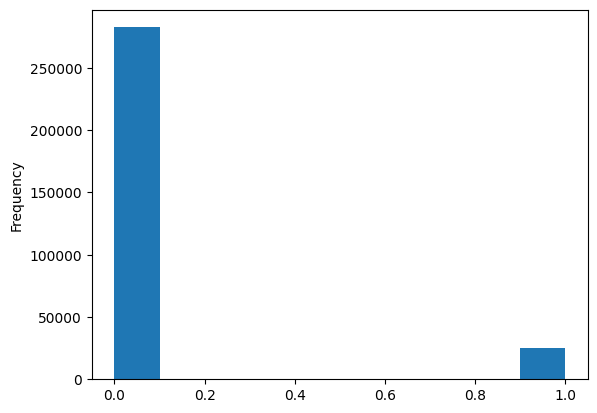

In [7]:
app_train['TARGET'].astype(int).plot.hist()

## Analyse des valeurs manquantes

In [8]:
from utils import missing_values_table

In [9]:
# Missing values statistics
missing_values = missing_values_table(app_train)
missing_values.head(20)

Le dataframe contient 122 colonnes.
67 colonnes ont des valeurs manquantes.


,% Missing,Above Threshold
COMMONAREA_MEDI,69.872297,True
COMMONAREA_MODE,69.872297,True
COMMONAREA_AVG,69.872297,True
NONLIVINGAPARTMENTS_MODE,69.432963,True
NONLIVINGAPARTMENTS_MEDI,69.432963,True
NONLIVINGAPARTMENTS_AVG,69.432963,True
FONDKAPREMONT_MODE,68.386172,True
LIVINGAPARTMENTS_AVG,68.354953,True
LIVINGAPARTMENTS_MEDI,68.354953,True
LIVINGAPARTMENTS_MODE,68.354953,True


## Types de colonnes

In [10]:
# Number of each type of column
app_train.dtypes.value_counts()

float64    65
int64      41
object     16
Name: count, dtype: int64

In [11]:
# Number of unique classes in each object column
app_train.select_dtypes('object').apply(pd.Series.nunique, axis = 0)

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

## Encoding des variables catégorielles

In [12]:
# Configurer MLflow pour utiliser le serveur
mlflow.set_tracking_uri("http://ec2-51-20-85-239.eu-north-1.compute.amazonaws.com:5000/")

## Aller plus loin dans l'analyse

### Identifier les anomalies

In [13]:
(app_train['DAYS_BIRTH'] / -365).describe()

count    307511.000000
mean         43.936973
std          11.956133
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: DAYS_BIRTH, dtype: float64

La répartition des âges parait conforme.

In [14]:
app_train['DAYS_EMPLOYED'].describe()

count    307511.000000
mean      63815.045904
std      141275.766519
min      -17912.000000
25%       -2760.000000
50%       -1213.000000
75%        -289.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64

La valeur maximale semble erronée => +100 ans

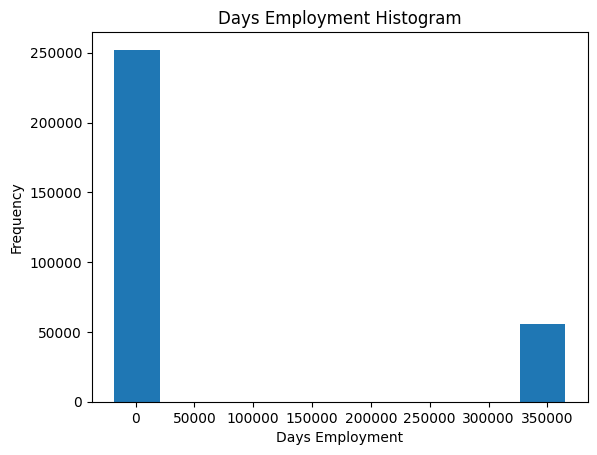

In [15]:
app_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram');
plt.xlabel('Days Employment');

In [16]:
# Part des anomalies
anom = app_train[app_train['DAYS_EMPLOYED'] == 365243]
non_anom = app_train[app_train['DAYS_EMPLOYED'] != 365243]
print('The non-anomalies default on %0.2f%% of loans' % (100 * non_anom['TARGET'].mean()))
print('The anomalies default on %0.2f%% of loans' % (100 * anom['TARGET'].mean()))
print('There are %d anomalous days of employment' % len(anom))

The non-anomalies default on 8.66% of loans
The anomalies default on 5.40% of loans
There are 55374 anomalous days of employment


Les anomalies ont moins de défaut de paiement

In [17]:
app_train_anom=app_train.copy()
app_train_anom

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,Cash loans,M,N,N,0,157500.0,254700.0,27558.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307507,456252,0,Cash loans,F,N,Y,0,72000.0,269550.0,12001.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307508,456253,0,Cash loans,F,N,Y,0,153000.0,677664.0,29979.0,...,0,0,0,0,1.0,0.0,0.0,1.0,0.0,1.0
307509,456254,1,Cash loans,F,N,Y,0,171000.0,370107.0,20205.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


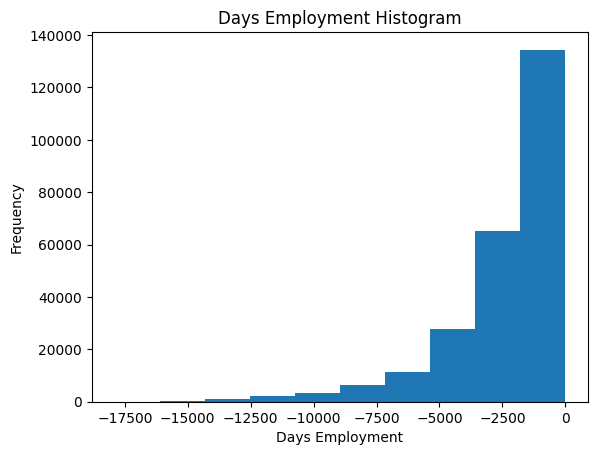

In [18]:
# Create an anomalous flag column
app_train_anom['DAYS_EMPLOYED_ANOM'] = app_train_anom["DAYS_EMPLOYED"] == 365243

# Replace the anomalous values with nan
app_train_anom['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)

app_train_anom['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram');
plt.xlabel('Days Employment');

La distribution est visuelelment plus cohérente

In [19]:
app_train_anom

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,DAYS_EMPLOYED_ANOM
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,False
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,False
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,False
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,False
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,Cash loans,M,N,N,0,157500.0,254700.0,27558.0,...,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,False
307507,456252,0,Cash loans,F,N,Y,0,72000.0,269550.0,12001.5,...,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,True
307508,456253,0,Cash loans,F,N,Y,0,153000.0,677664.0,29979.0,...,0,0,0,1.0,0.0,0.0,1.0,0.0,1.0,False
307509,456254,1,Cash loans,F,N,Y,0,171000.0,370107.0,20205.0,...,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,False


In [20]:
app_test_anom=app_test.copy()

In [21]:
app_test_anom['DAYS_EMPLOYED_ANOM'] = app_test_anom["DAYS_EMPLOYED"] == 365243
app_test_anom["DAYS_EMPLOYED"].replace({365243: np.nan}, inplace = True)

print('There are %d anomalies in the test data out of %d entries' % (app_test_anom["DAYS_EMPLOYED_ANOM"].sum(), len(app_test_anom)))

There are 9274 anomalies in the test data out of 48744 entries


### Identifier les corrélations

In [22]:
app_train_copy = app_train.copy()

In [23]:
app_train_copy

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,Cash loans,M,N,N,0,157500.0,254700.0,27558.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307507,456252,0,Cash loans,F,N,Y,0,72000.0,269550.0,12001.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307508,456253,0,Cash loans,F,N,Y,0,153000.0,677664.0,29979.0,...,0,0,0,0,1.0,0.0,0.0,1.0,0.0,1.0
307509,456254,1,Cash loans,F,N,Y,0,171000.0,370107.0,20205.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


Méthode de corrélation avancée : 
- Prend en compte les variables continues avec Pearson et Spearman
- Gère les variables catégorielles encodées avec Cramér’s V
- Capture les relations non linéaires avec Mutual Information
- Évite les problèmes de biais liés aux méthodes classiques

La corrélation positive la plus importante avec la variable cible est "DAYS_BIRTH". Pour rappel, il s'agit de l'âge en jour du client au moment du prêt. Comme la valeur de la variable est négative, cela signifie qu'au plus le client est âgé, au plus le client a de chances de rembourser le prêt à temps.
La corrélation négtive la plus importante est "EXT_SOURCE_3", qui serait un score normalisé d'une source de donnée externe. Nous analyserons ça dans la section "Corrélation négative".

#### Corrélation positive

In [24]:
# Find the correlation of the positive days since birth and target
app_train['DAYS_BIRTH'] = abs(app_train['DAYS_BIRTH'])
app_train['DAYS_BIRTH'].corr(app_train['TARGET'])

np.float64(-0.07823930830982694)

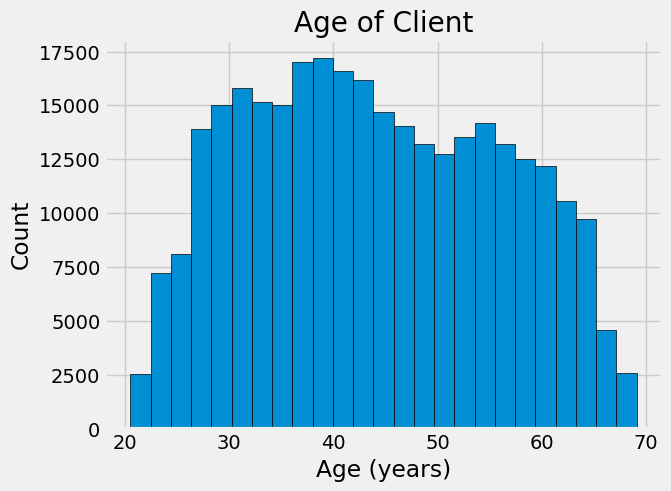

In [25]:
# Set the style of plots
plt.style.use('fivethirtyeight')

# Plot the distribution of ages in years
plt.hist(app_train['DAYS_BIRTH'] / 365, edgecolor = 'k', bins = 25)
plt.title('Age of Client'); plt.xlabel('Age (years)'); plt.ylabel('Count');

Le graph ne nous donne pas suffisamment d'indication sur les outliers comme les âges sont pertinents. Afin de mieux visualiser, nous allons conduire un KDE. 

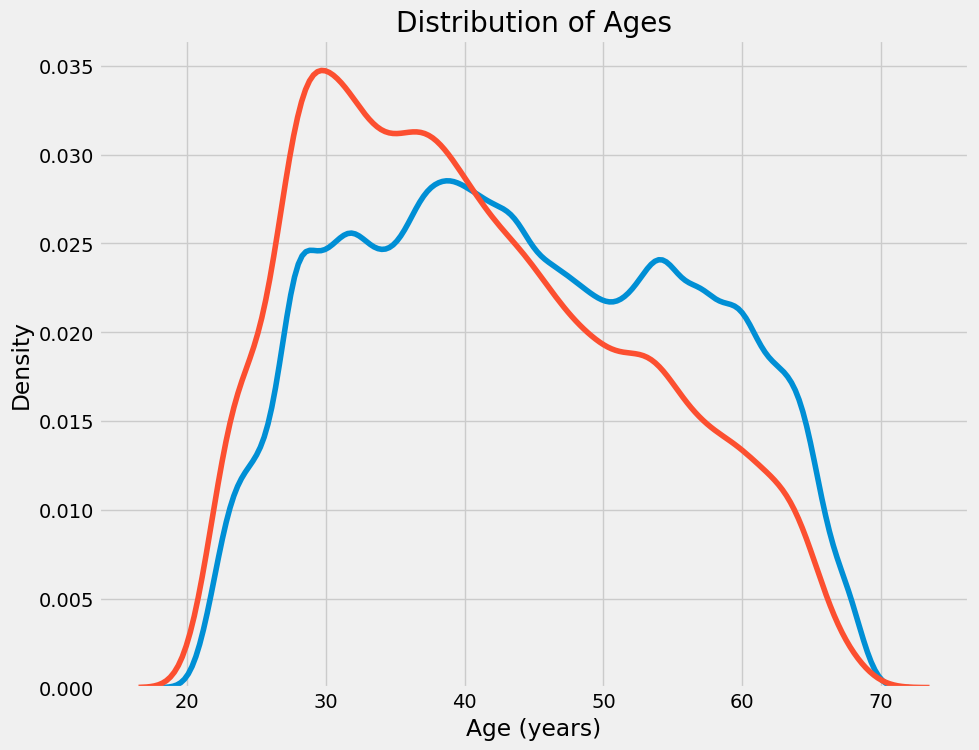

In [26]:
plt.figure(figsize = (10, 8))

# KDE plot of loans that were repaid on time
sns.kdeplot(app_train.loc[app_train['TARGET'] == 0, 'DAYS_BIRTH'] / 365, label = 'target == 0')

# KDE plot of loans which were not repaid on time
sns.kdeplot(app_train.loc[app_train['TARGET'] == 1, 'DAYS_BIRTH'] / 365, label = 'target == 1')

# Labeling of plot
plt.xlabel('Age (years)'); plt.ylabel('Density'); plt.title('Distribution of Ages');

Rouge : Target == 1 (Prêts non remmboursés à temps)
Bleu : Target == 0 (Prêts remboursés à temps)

In [27]:
# Age information into a separate dataframe
age_data = app_train[['TARGET', 'DAYS_BIRTH']]
age_data['YEARS_BIRTH'] = age_data['DAYS_BIRTH'] / 365

# Bin the age data
age_data['YEARS_BINNED'] = pd.cut(age_data['YEARS_BIRTH'], bins = np.linspace(20, 70, num = 11))
age_data.head(10)

,TARGET,DAYS_BIRTH,YEARS_BIRTH,YEARS_BINNED
0,1,9461,25.920548,"(25.0, 30.0]"
1,0,16765,45.931507,"(45.0, 50.0]"
2,0,19046,52.180822,"(50.0, 55.0]"
3,0,19005,52.068493,"(50.0, 55.0]"
4,0,19932,54.608219,"(50.0, 55.0]"
5,0,16941,46.413699,"(45.0, 50.0]"
6,0,13778,37.747945,"(35.0, 40.0]"
7,0,18850,51.643836,"(50.0, 55.0]"
8,0,20099,55.065753,"(55.0, 60.0]"
9,0,14469,39.641096,"(35.0, 40.0]"


In [28]:
# Group by the bin and calculate averages
age_groups  = age_data.groupby('YEARS_BINNED').mean()
age_groups

,TARGET,DAYS_BIRTH,YEARS_BIRTH
YEARS_BINNED,,,
"(20.0, 25.0]",0.123036,8532.795625,23.377522
"(25.0, 30.0]",0.111436,10155.219250,27.822518
"(30.0, 35.0]",0.102814,11854.848377,32.479037
"(35.0, 40.0]",0.089414,13707.908253,37.555913
"(40.0, 45.0]",0.078491,15497.661233,42.459346
"(45.0, 50.0]",0.074171,17323.900441,47.462741
"(50.0, 55.0]",0.066968,19196.494791,52.593136
"(55.0, 60.0]",0.055314,20984.262742,57.491131
"(60.0, 65.0]",0.052737,22780.547460,62.412459


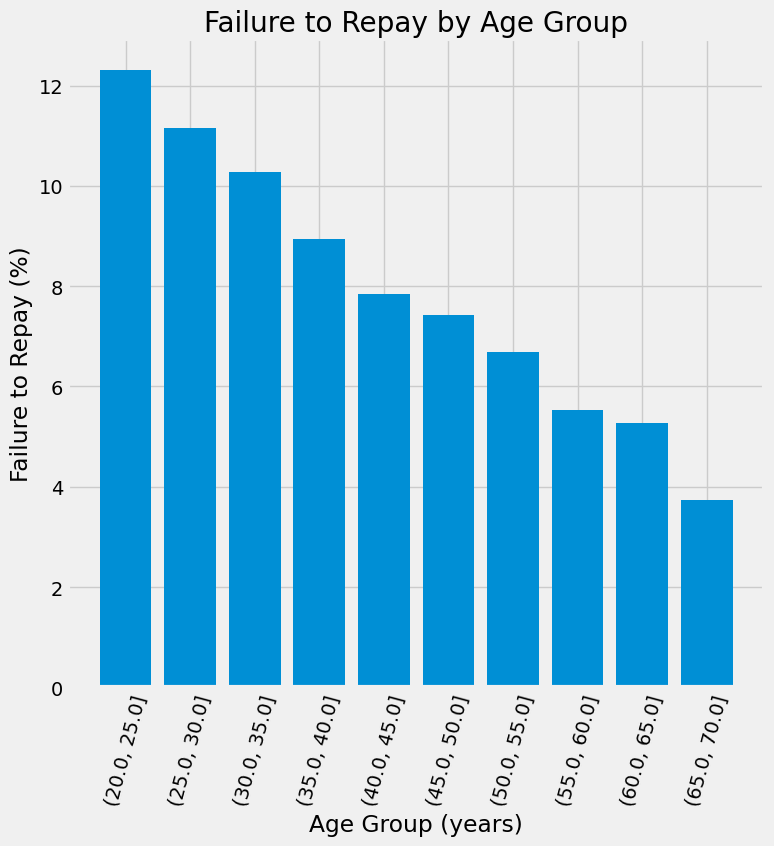

In [29]:
plt.figure(figsize = (8, 8))

# Graph the age bins and the average of the target as a bar plot
plt.bar(age_groups.index.astype(str), 100 * age_groups['TARGET'])

# Plot labeling
plt.xticks(rotation = 75); plt.xlabel('Age Group (years)'); plt.ylabel('Failure to Repay (%)')
plt.title('Failure to Repay by Age Group');

La tendance est plus claire ici : 
Au plus le client est jeune, au plus il a de risques de ne pas rembourser son prêt à temps.
Pour un client entre 20 et 25 ans, le risque est de +12% contre un peu moins de 4% pour un client de 65-70 ans, soit 3 fois plus important.

#### Corrélation négative

Les 3 variables ayant la corrélation négative la plus importantes sont EXT_SOURCE_1, EXT_SOURCE_2, et EXT_SOURCE_3. Nous allons regarder plus précisément leurs corrélations.

In [30]:
# Extract the EXT_SOURCE variables and show correlations
ext_data = app_train[['TARGET', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']]
ext_data_corrs = ext_data.corr()
ext_data_corrs

,TARGET,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,DAYS_BIRTH
TARGET,1.000000,-0.155317,-0.160472,-0.178919,-0.078239
EXT_SOURCE_1,-0.155317,1.000000,0.213982,0.186846,0.600610
EXT_SOURCE_2,-0.160472,0.213982,1.000000,0.109167,0.091996
EXT_SOURCE_3,-0.178919,0.186846,0.109167,1.000000,0.205478
DAYS_BIRTH,-0.078239,0.600610,0.091996,0.205478,1.000000


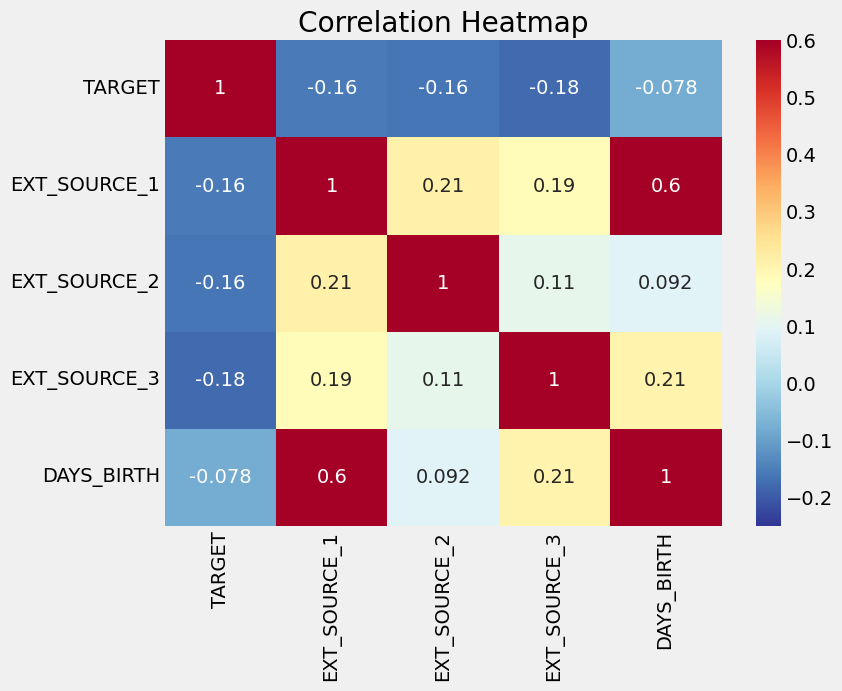

In [31]:
plt.figure(figsize = (8, 6))

# Heatmap of correlations
sns.heatmap(ext_data_corrs, cmap = plt.cm.RdYlBu_r, vmin = -0.25, annot = True, vmax = 0.6)
plt.title('Correlation Heatmap');

Pour nos 3 variables EXT, si elles augementent, alors la probabilité que le client rembourse son prêt augmente également.
De plus, on remarque une corrélation positive "importante" entre DAYS_BIRTH et EXT_SOURCE_1, ce qui peut signifier que pour ce dernier, l'âge du client est un critère important.

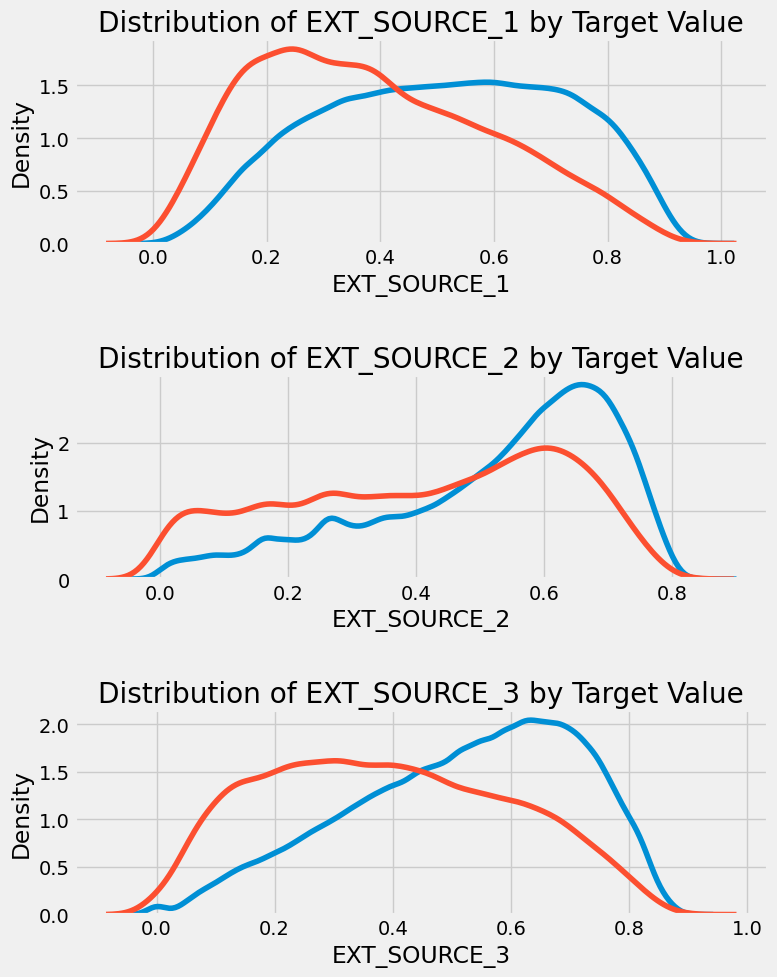

In [32]:
# Distribution des EXT_SOURCE selon la target
plt.figure(figsize = (8, 10))

# iterate through the sources
for i, source in enumerate(['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']):
    
    # create a new subplot for each source
    plt.subplot(3, 1, i + 1)
    # plot repaid loans
    sns.kdeplot(app_train.loc[app_train['TARGET'] == 0, source], label = 'target == 0')
    # plot loans that were not repaid
    sns.kdeplot(app_train.loc[app_train['TARGET'] == 1, source], label = 'target == 1')
    
    # Label the plots
    plt.title('Distribution of %s by Target Value' % source)
    plt.xlabel('%s' % source); plt.ylabel('Density');
    
plt.tight_layout(h_pad = 2.5)

Les relations sont assez faibles mais ces variables peuvent demeurer utiles lorsqu'on regarde les corrélations. Par exemple, EXT_SOURCE_3, pourrait correspondre à la probabilité de remboursement de prêt.

## Pairs plot

Le pair plot permet d'identifier les relations entre les pairs de variables ainsi que les distributions de chacunes.

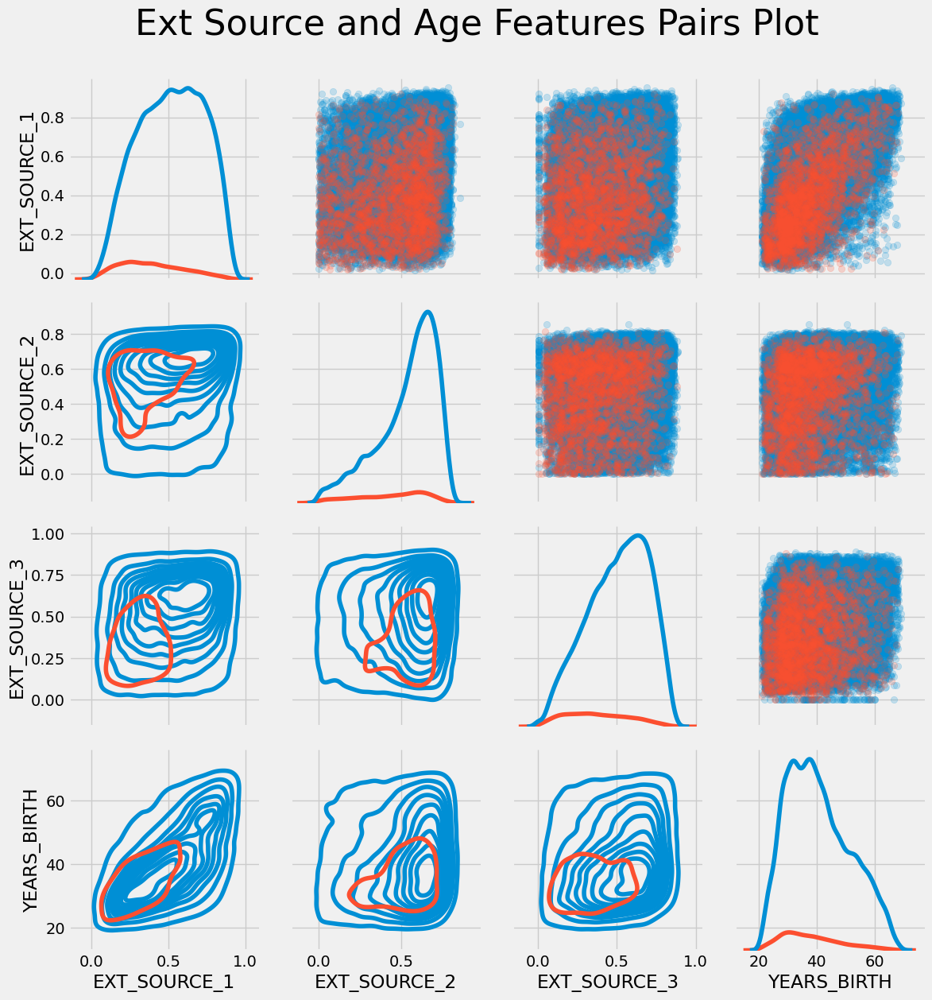

In [33]:
# Copy the data for plotting
plot_data = ext_data.drop(columns = ['DAYS_BIRTH']).copy()

# Add in the age of the client in years
plot_data['YEARS_BIRTH'] = age_data['YEARS_BIRTH']

# Drop na values and limit to first 100000 rows
plot_data = plot_data.dropna().loc[:100000, :]

# Function to calculate correlation coefficient between two columns
def corr_func(x, y, **kwargs):
    r = np.corrcoef(x, y)[0][1]
    ax = plt.gca()
    ax.annotate("r = {:.2f}".format(r),
                xy=(.2, .8), xycoords=ax.transAxes,
                size = 20)

# Create the pairgrid object
grid = sns.PairGrid(data = plot_data, height=3, diag_sharey=False,
                    hue = 'TARGET', 
                    vars = [x for x in list(plot_data.columns) if x != 'TARGET'])

# Upper is a scatter plot
grid.map_upper(plt.scatter, alpha = 0.2)

# Diagonal is a histogram
grid.map_diag(sns.kdeplot)

# Bottom is density plot
grid.map_lower(sns.kdeplot, cmap = plt.cm.OrRd_r);

plt.suptitle('Ext Source and Age Features Pairs Plot', size = 32, y = 1.05);

Rouge = les prêtes impayés
Bleu = prêtes payés
Encore une fois on retrouve une relation entre EXT_SOURCE_1 DAYS_BIRTH (ou YEARS_BIRTH), ce qui renforce la probabilité que ext_source y soit très sensible.

# Feature engineering 1

## Features polynomiales

In [34]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.impute import SimpleImputer


In [35]:
# Make a new dataframe for polynomial features
poly_features = app_train[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH', 'TARGET']]
poly_features_test = app_test[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']]

# imputer for handling missing values
imputer = SimpleImputer(strategy='median')  
poly_target = poly_features['TARGET']

# Supprimer la colonne TARGET pour ne garder que les features
poly_features = poly_features.drop(columns=['TARGET'])

# Imputation des valeurs manquantes
poly_features = imputer.fit_transform(poly_features)
poly_features_test = imputer.transform(poly_features_test)

# Create the polynomial object with specified degree
poly_transformer = PolynomialFeatures(degree=3)

# Transformation des données
poly_features = poly_transformer.fit_transform(poly_features)
poly_features_test = poly_transformer.transform(poly_features_test)

In [36]:
# Make a new dataframe for polynomial features
poly_features = app_train[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH', 'TARGET']]
poly_features_test = app_test[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']]

# Imputer for handling missing values
imputer = SimpleImputer(strategy='median')  
poly_target = poly_features['TARGET']

# Supprimer la colonne TARGET pour ne garder que les features
poly_features = poly_features.drop(columns=['TARGET'])

# Imputation des valeurs manquantes
poly_features = imputer.fit_transform(poly_features)
poly_features_test = imputer.transform(poly_features_test)

# Create the polynomial object with specified degree
poly_transformer = PolynomialFeatures(degree=3)

# Une seule transformation des données
poly_features = poly_transformer.fit_transform(poly_features)
poly_features_test = poly_transformer.transform(poly_features_test)

print('Polynomial Features shape: ', poly_features.shape)

Polynomial Features shape:  (307511, 35)


Nous avons un grand nombre de features, pour avoir le nom nous utilisons la méthode suivante :

In [37]:
poly_transformer.get_feature_names_out(input_features = ['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH'])[:15]

array(['1', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH',
       'EXT_SOURCE_1^2', 'EXT_SOURCE_1 EXT_SOURCE_2',
       'EXT_SOURCE_1 EXT_SOURCE_3', 'EXT_SOURCE_1 DAYS_BIRTH',
       'EXT_SOURCE_2^2', 'EXT_SOURCE_2 EXT_SOURCE_3',
       'EXT_SOURCE_2 DAYS_BIRTH', 'EXT_SOURCE_3^2',
       'EXT_SOURCE_3 DAYS_BIRTH', 'DAYS_BIRTH^2'], dtype=object)

Chaque feature a été rendue puissance 3.

In [38]:
# Create a dataframe of the features 
poly_features = pd.DataFrame(poly_features, 
                             columns = poly_transformer.get_feature_names_out(['EXT_SOURCE_1', 'EXT_SOURCE_2', 
                                                                           'EXT_SOURCE_3', 'DAYS_BIRTH']))

# Add in the target
poly_features['TARGET'] = poly_target

# Find the correlations with the target
poly_corrs = poly_features.corr()['TARGET'].sort_values()

# Display most negative and most positive
print(poly_corrs.head(10))
print(poly_corrs.tail(5))

EXT_SOURCE_2 EXT_SOURCE_3                -0.193939
EXT_SOURCE_1 EXT_SOURCE_2 EXT_SOURCE_3   -0.189605
EXT_SOURCE_2 EXT_SOURCE_3 DAYS_BIRTH     -0.181283
EXT_SOURCE_2^2 EXT_SOURCE_3              -0.176428
EXT_SOURCE_2 EXT_SOURCE_3^2              -0.172282
EXT_SOURCE_1 EXT_SOURCE_2                -0.166625
EXT_SOURCE_1 EXT_SOURCE_3                -0.164065
EXT_SOURCE_2                             -0.160295
EXT_SOURCE_2 DAYS_BIRTH                  -0.156873
EXT_SOURCE_1 EXT_SOURCE_2^2              -0.156867
Name: TARGET, dtype: float64
DAYS_BIRTH     -0.078239
DAYS_BIRTH^2   -0.076672
DAYS_BIRTH^3   -0.074273
TARGET          1.000000
1                    NaN
Name: TARGET, dtype: float64


Plusieurs des nouvelles features ont une corrélation plus importante que les originales. Ce qui sera très utile pour le machine learning.

In [39]:
# Put test features into dataframe
poly_features_test = pd.DataFrame(poly_features_test, 
                                  columns = poly_transformer.get_feature_names_out(['EXT_SOURCE_1', 'EXT_SOURCE_2', 
                                                                                'EXT_SOURCE_3', 'DAYS_BIRTH']))

# Merge polynomial features into training dataframe
poly_features['SK_ID_CURR'] = app_train['SK_ID_CURR']
app_train_poly = app_train.merge(poly_features, on = 'SK_ID_CURR', how = 'left')

# Merge polnomial features into testing dataframe
poly_features_test['SK_ID_CURR'] = app_test['SK_ID_CURR']
app_test_poly = app_test.merge(poly_features_test, on = 'SK_ID_CURR', how = 'left')

# Align the dataframes
app_train_poly, app_test_poly = app_train_poly.align(app_test_poly, join = 'inner', axis = 1)

# Print out the new shapes
print('Training data with polynomial features shape: ', app_train_poly.shape)
print('Testing data with polynomial features shape:  ', app_test_poly.shape)

Training data with polynomial features shape:  (307511, 156)
Testing data with polynomial features shape:   (48744, 156)


In [40]:
poly_features['TARGET']

0         1
1         0
2         0
3         0
4         0
         ..
307506    0
307507    0
307508    0
307509    1
307510    0
Name: TARGET, Length: 307511, dtype: int64

## Domain Knowledge

- CREDIT_INCOME_PERCENT: the percentage of the credit amount relative to a client's income
- ANNUITY_INCOME_PERCENT: the percentage of the loan annuity relative to a client's income
- CREDIT_TERM: the length of the payment in months (since the annuity is the monthly amount due
- DAYS_EMPLOYED_PERCENT: the percentage of the days employed relative to the client's age

In [41]:
app_train_domain = app_train.copy()
app_test_domain = app_test.copy()

app_train_domain['CREDIT_INCOME_PERCENT'] = app_train_domain['AMT_CREDIT'] / app_train_domain['AMT_INCOME_TOTAL']
app_train_domain['ANNUITY_INCOME_PERCENT'] = app_train_domain['AMT_ANNUITY'] / app_train_domain['AMT_INCOME_TOTAL']
app_train_domain['CREDIT_TERM'] = app_train_domain['AMT_ANNUITY'] / app_train_domain['AMT_CREDIT']
app_train_domain['DAYS_EMPLOYED_PERCENT'] = app_train_domain['DAYS_EMPLOYED'] / app_train_domain['DAYS_BIRTH']

In [42]:
app_test_domain['CREDIT_INCOME_PERCENT'] = app_test_domain['AMT_CREDIT'] / app_test_domain['AMT_INCOME_TOTAL']
app_test_domain['ANNUITY_INCOME_PERCENT'] = app_test_domain['AMT_ANNUITY'] / app_test_domain['AMT_INCOME_TOTAL']
app_test_domain['CREDIT_TERM'] = app_test_domain['AMT_ANNUITY'] / app_test_domain['AMT_CREDIT']
app_test_domain['DAYS_EMPLOYED_PERCENT'] = app_test_domain['DAYS_EMPLOYED'] / app_test_domain['DAYS_BIRTH']

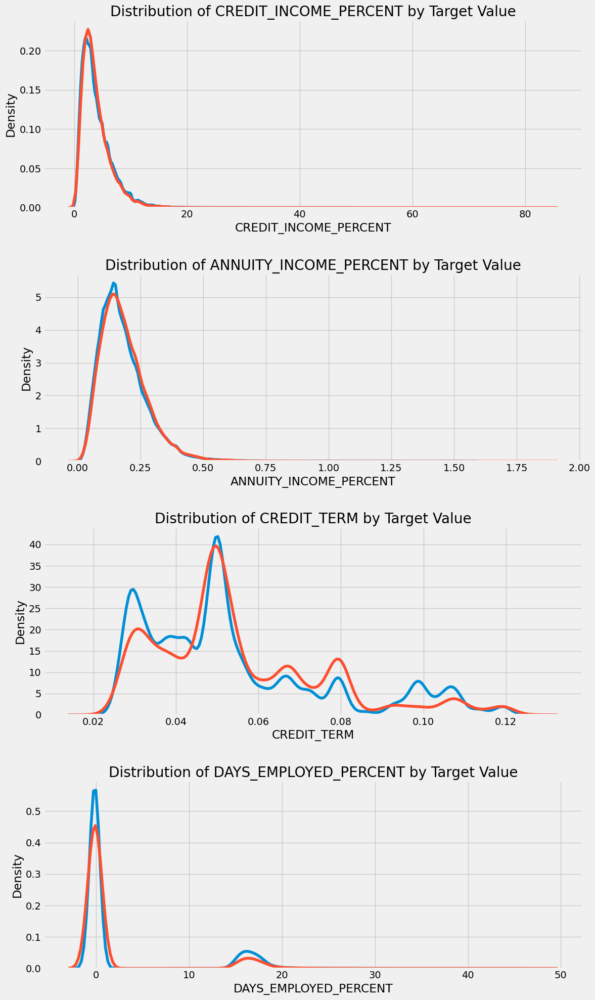

In [43]:
plt.figure(figsize = (12, 20))
# iterate through the new features
for i, feature in enumerate(['CREDIT_INCOME_PERCENT', 'ANNUITY_INCOME_PERCENT', 'CREDIT_TERM', 'DAYS_EMPLOYED_PERCENT']):
    
    # create a new subplot for each source
    plt.subplot(4, 1, i + 1)
    # plot repaid loans
    sns.kdeplot(app_train_domain.loc[app_train_domain['TARGET'] == 0, feature], label = 'target == 0')
    # plot loans that were not repaid
    sns.kdeplot(app_train_domain.loc[app_train_domain['TARGET'] == 1, feature], label = 'target == 1')
    
    # Label the plots
    plt.title('Distribution of %s by Target Value' % feature)
    plt.xlabel('%s' % feature); plt.ylabel('Density');
    
plt.tight_layout(h_pad = 2.5)

# LightGBM

In [44]:
from sklearn.model_selection import KFold
from sklearn.metrics import roc_auc_score
import gc

In [45]:
import lightgbm as lgb
from lightgbm import LGBMClassifier

In [46]:
def model(features, test_features, encoding = 'ohe', n_folds = 5):
    
    """Train and test a light gradient boosting model using
    cross validation. 
    
    Parameters
    --------
        features (pd.DataFrame): 
            dataframe of training features to use 
            for training a model. Must include the TARGET column.
        test_features (pd.DataFrame): 
            dataframe of testing features to use
            for making predictions with the model. 
        encoding (str, default = 'ohe'): 
            method for encoding categorical variables. Either 'ohe' for one-hot encoding or 'le' for integer label encoding
            n_folds (int, default = 5): number of folds to use for cross validation
        
    Return
    --------
        submission (pd.DataFrame): 
            dataframe with `SK_ID_CURR` and `TARGET` probabilities
            predicted by the model.
        feature_importances (pd.DataFrame): 
            dataframe with the feature importances from the model.
        valid_metrics (pd.DataFrame): 
            dataframe with training and validation metrics (ROC AUC) for each fold and overall.
        
    """
    
    # Extract the ids
    train_ids = features['SK_ID_CURR']
    test_ids = test_features['SK_ID_CURR']
    
    # Extract the labels for training
    labels = features['TARGET']
    
    # Remove the ids and target
    features = features.drop(columns = ['SK_ID_CURR', 'TARGET'])
    test_features = test_features.drop(columns = ['SK_ID_CURR'])
    
    
    # One Hot Encoding
    if encoding == 'ohe':
        features = pd.get_dummies(features)
        test_features = pd.get_dummies(test_features)
        
        # Align the dataframes by the columns
        features, test_features = features.align(test_features, join = 'inner', axis = 1)
        
        # No categorical indices to record
        cat_indices = 'auto'
    
    # Integer label encoding
    elif encoding == 'le':
        
        # Create a label encoder
        label_encoder = LabelEncoder()
        
        # List for storing categorical indices
        cat_indices = []
        
        # Iterate through each column
        for i, col in enumerate(features):
            if features[col].dtype == 'object':
                # Map the categorical features to integers
                features[col] = label_encoder.fit_transform(np.array(features[col].astype(str)).reshape((-1,)))
                test_features[col] = label_encoder.transform(np.array(test_features[col].astype(str)).reshape((-1,)))

                # Record the categorical indices
                cat_indices.append(i)
    
    # Catch error if label encoding scheme is not valid
    else:
        raise ValueError("Encoding must be either 'ohe' or 'le'")
        
    print('Training Data Shape: ', features.shape)
    print('Testing Data Shape: ', test_features.shape)
    
    # Extract feature names
    feature_names = list(features.columns)
    
    # Convert to np arrays
    features = np.array(features)
    test_features = np.array(test_features)
    
    # Create the kfold object
    k_fold = KFold(n_splits = n_folds, shuffle = True, random_state = 50)
    
    # Empty array for feature importances
    feature_importance_values = np.zeros(len(feature_names))
    
    # Empty array for test predictions
    test_predictions = np.zeros(test_features.shape[0])
    
    # Empty array for out of fold validation predictions
    out_of_fold = np.zeros(features.shape[0])
    
    # Lists for recording validation and training scores
    valid_scores = []
    train_scores = []
    
    # Iterate through each fold
    for train_indices, valid_indices in k_fold.split(features):
        
        # Training data for the fold
        train_features, train_labels = features[train_indices], labels[train_indices]
        # Validation data for the fold
        valid_features, valid_labels = features[valid_indices], labels[valid_indices]
        
        # Create the model
        model = lgb.LGBMClassifier(n_estimators=10000, objective = 'binary', 
                                   class_weight = 'balanced', learning_rate = 0.05, 
                                   reg_alpha = 0.1, reg_lambda = 0.1, 
                                   subsample = 0.8, n_jobs = -1, random_state = 50,
                                   early_stopping_rounds = 100, verbose = 200)
        
        # Train the model
        model.fit(train_features, train_labels, eval_metric = 'auc',
                  eval_set = [(valid_features, valid_labels), (train_features, train_labels)],
                  eval_names = ['valid', 'train'], categorical_feature = cat_indices)
        
        # Record the best iteration
        best_iteration = model.best_iteration_
        
        # Record the feature importances
        feature_importance_values += model.feature_importances_ / k_fold.n_splits
        
        # Make predictions
        test_predictions += model.predict_proba(test_features, num_iteration = best_iteration)[:, 1] / k_fold.n_splits
        
        # Record the out of fold predictions
        out_of_fold[valid_indices] = model.predict_proba(valid_features, num_iteration = best_iteration)[:, 1]
        
        # Record the best score
        valid_score = model.best_score_['valid']['auc']
        train_score = model.best_score_['train']['auc']
        
        valid_scores.append(valid_score)
        train_scores.append(train_score)
        
        # Clean up memory
        gc.enable()
        del model, train_features, valid_features
        gc.collect()
        
    # Make the submission dataframe
    submission = pd.DataFrame({'SK_ID_CURR': test_ids, 'TARGET': test_predictions})
    
    # Make the feature importance dataframe
    feature_importances = pd.DataFrame({'feature': feature_names, 'importance': feature_importance_values})
    
    # Overall validation score
    valid_auc = roc_auc_score(labels, out_of_fold)
    
    # Add the overall scores to the metrics
    valid_scores.append(valid_auc)
    train_scores.append(np.mean(train_scores))
    
    # Needed for creating dataframe of validation scores
    fold_names = list(range(n_folds))
    fold_names.append('overall')
    
    # Dataframe of validation scores
    metrics = pd.DataFrame({'fold': fold_names,
                            'train': train_scores,
                            'valid': valid_scores}) 
    
    return submission, feature_importances, metrics

In [47]:
submission, fi, metrics = model(app_train, app_test)
print('Baseline metrics')
print(metrics)

KeyboardInterrupt: 

# Prédiction (première)

Objectif : Définir un score métier pour l'entraînement et l'évaluation des modèles

L'idée est de créer une métrique personnalisée qui reflète les enjeux métier en attribuant un coût différent aux faux positifs (FP) et aux faux négatifs (FN).
Ensuite, ce score sera utilisé pour évaluer et optimiser les modèles.

In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Drop the target from the training data
if 'TARGET' in app_train:
    train = app_train.drop(columns = ['TARGET'])
else:
    train = app_train.copy()
    
# Feature names
features = list(train.columns)

# Copy of the testing data
test = app_test.copy()

# Median imputation of missing values
imputer = SimpleImputer(strategy = 'median')

# Scale each feature to 0-1
scaler = MinMaxScaler(feature_range = (0, 1))

# Fit on the training data
imputer.fit(train)

# Transform both training and testing data
train = imputer.transform(train)
test = imputer.transform(app_test)

# Repeat with the scaler
scaler.fit(train)
train = scaler.transform(train)
test = scaler.transform(test)

print('Training data shape: ', train.shape)
print('Testing data shape: ', test.shape)

Training data shape:  (307511, 121)
Testing data shape:  (48744, 121)


In [ ]:
from sklearn.linear_model import LogisticRegression

# Make the model with the specified regularization parameter
log_reg = LogisticRegression(C = 0.0001)

# Train on the training data
log_reg.fit(train, train_labels)

LogisticRegression(C=0.0001)

In [ ]:
# Make predictions
# Make sure to select the second column only
log_reg_pred = log_reg.predict_proba(test)[:, 1]

In [ ]:
# Submission dataframe
submit = app_test[['SK_ID_CURR']]
submit['TARGET'] = log_reg_pred

submit.head()

,SK_ID_CURR,TARGET
0,100001,0.090402
1,100005,0.122256
2,100013,0.084338
3,100028,0.083248
4,100038,0.124639


In [ ]:
# Make the random forest classifier
random_forest = RandomForestClassifier(n_estimators = 100, random_state = 50, verbose = 1, n_jobs = -1)

In [ ]:
# Train on the training data
random_forest.fit(train, train_labels)

# Extract feature importances
feature_importance_values = random_forest.feature_importances_
feature_importances = pd.DataFrame({'feature': features, 'importance': feature_importance_values})

# Make predictions on the test data
predictions = random_forest.predict_proba(test)[:, 1]

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 4 concurrent workers.


[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  2.7min finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    0.8s finished


In [ ]:
# Make a submission dataframe
submit = app_test[['SK_ID_CURR']]
submit['TARGET'] = predictions

# Save the submission dataframe
submit.to_csv('random_forest_baseline.csv', index = False)

## Prédiction avancée

In [53]:
import mlflow
import pandas as pd

# Configurer MLflow pour utiliser le serveur distant avec les identifiants spécifiés
mlflow.set_tracking_uri("http://ec2-51-20-85-239.eu-north-1.compute.amazonaws.com:5000/")

# Run ID
run_id = "2c7d72ff06314a02b8d516519a1fcb6f"

# Charger le modèle qui contient tous les encoders
encoders_model_uri = f"runs:/{run_id}/label_encoders"
encoders = mlflow.sklearn.load_model(encoders_model_uri)

# Appliquer l'encoding
le_count = 0

for col, encoder in encoders.items():
    if col in app_train.columns:
        try:
            # Transformer les données
            app_train[col] = encoder.transform(app_train[col])
            app_test[col] = encoder.transform(app_test[col])
            # Incrémenter le compteur
            le_count += 1
        except Exception as e:
            # Afficher l'erreur dans le notebook
            print(f"Erreur lors du chargement de l'encoder pour la colonne {col}: {e}")

# One-hot encoding
app_train = pd.get_dummies(app_train)
app_test = pd.get_dummies(app_test)

# Afficher le nombre de colonnes encodées
print(f"Nombre de colonnes encodées : {le_count}")


Nombre de colonnes encodées : 16


In [54]:
train_sample=app_train.iloc[:62000]
test_sample=app_test.iloc[:10000]

In [56]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import KFold
import lightgbm as lgb
import gc
from sklearn.impute import SimpleImputer
import mlflow
import mlflow.sklearn

def preprocess_data(features, test_features, encoding='ohe'):

    # Extract the ids
    train_ids = features['SK_ID_CURR']
    test_ids = test_features['SK_ID_CURR']

    # Extract the labels for training
    labels = features['TARGET']

    # Remove the ids and target
    features = features.drop(columns=['SK_ID_CURR', 'TARGET'])
    test_features = test_features.drop(columns=['SK_ID_CURR'])

    # Impute missing values
    imputer = SimpleImputer(strategy="mean")
    features = imputer.fit_transform(features)
    test_features = imputer.transform(test_features)

    # Log the imputer in MLflow
    with mlflow.start_run(run_name="Imputer") as run:
        mlflow.sklearn.log_model(imputer, "imputer")
        mlflow.log_param("imputer_strategy", "mean")

    # One Hot Encoding
    if encoding == 'ohe':
        features = pd.get_dummies(pd.DataFrame(features))
        test_features = pd.get_dummies(pd.DataFrame(test_features))

        # Align the dataframes by the columns
        features, test_features = features.align(test_features, join='inner', axis=1)

        # No categorical indices to record
        cat_indices = 'auto'

    # Integer label encoding
    elif encoding == 'le':
        label_encoder = LabelEncoder()
        cat_indices = []

        # Iterate through each column
        for col in features.columns:
            if features[col].dtype == 'object':
                features[col] = label_encoder.fit_transform(np.array(features[col].astype(str)).reshape(-1,))
                test_features[col] = label_encoder.transform(np.array(test_features[col].astype(str)).reshape(-1,))
                cat_indices.append(col)

    # Catch error if label encoding scheme is not valid
    else:
        raise ValueError("Encoding must be either 'ohe' or 'le'")

    # Add the ids back to the dataframes
    features['SK_ID_CURR'] = train_ids
    test_features['SK_ID_CURR'] = test_ids

    print('Training Data Shape: ', features.shape)
    print('Testing Data Shape: ', test_features.shape)

    return features, test_features, labels, train_ids, test_ids, cat_indices

In [57]:
import mlflow
import mlflow.sklearn
from sklearn.metrics import accuracy_score, roc_auc_score, f1_score, recall_score, precision_score, confusion_matrix, make_scorer
from sklearn.dummy import DummyClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier

def model(features, test_features, labels, train_ids, test_ids, cat_indices, n_folds=5):

    # Extract feature names
    feature_names = list(features.columns)

    # Convert to np arrays
    features = np.array(features)
    test_features = np.array(test_features)

    # Create the kfold object
    k_fold = KFold(n_splits=n_folds, shuffle=True, random_state=50)

    # Empty array for feature importances
    feature_importance_values = np.zeros(len(feature_names))

    # Empty array for test predictions
    test_predictions = np.zeros(test_features.shape[0])

    # Empty array for out of fold validation predictions
    out_of_fold = np.zeros(features.shape[0])

    # Lists for recording validation and training scores
    valid_scores = []
    train_scores = []

    # Define models
    models = {
        "DummyClassifier": DummyClassifier(strategy="most_frequent"),
        "DecisionTree": DecisionTreeClassifier(),
        "RandomForestClassifier": RandomForestClassifier(n_estimators=100),
        "GradientBoosting": GradientBoostingClassifier(n_estimators=100)
    }

    # Set MLflow experiment
    mlflow.set_experiment("Model_Comparison_test_final")

    for model_name, model in models.items():
        with mlflow.start_run(run_name=model_name) as run:
            # Empty array for test predictions
            test_predictions = np.zeros(test_features.shape[0])

            # Empty array for out of fold validation predictions
            out_of_fold = np.zeros(features.shape[0])

            # Lists for recording validation and training scores
            valid_scores = []
            train_scores = []

            # Iterate through each fold
            for train_indices, valid_indices in k_fold.split(features):
                # Training data for the fold
                train_features, train_labels = features[train_indices], labels[train_indices]
                # Validation data for the fold
                valid_features, valid_labels = features[valid_indices], labels[valid_indices]

                # Train the model
                model.fit(train_features, train_labels)
                y_pred_val = model.predict_proba(valid_features)[:, 1]
                y_pred_test = model.predict_proba(test_features)[:, 1]

                # Record the out of fold predictions
                out_of_fold[valid_indices] = y_pred_val
                test_predictions += y_pred_test / n_folds

                # Record the best score
                valid_score = roc_auc_score(valid_labels, y_pred_val)
                train_score = roc_auc_score(train_labels, model.predict_proba(train_features)[:, 1])
                valid_scores.append(valid_score)
                train_scores.append(train_score)
                
                # Calculate feature importances if the model supports it
                if hasattr(model, 'feature_importances_'):
                    feature_importance_values += model.feature_importances_ / n_folds


            # Calculate overall validation score
            valid_auc = roc_auc_score(labels, out_of_fold)
            train_scores.append(np.mean(train_scores))
            valid_scores.append(valid_auc)

            # Make the submission dataframe
            submission = pd.DataFrame({'SK_ID_CURR': test_ids, 'TARGET': test_predictions})

            # Calculate business score
            y_pred = (out_of_fold >= 0.5).astype(int)

            # Score métier
            def business_score(y_true, y_pred, fp_weight=1, fn_weight=2):
                tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
                penalty = fp_weight * fp + fn_weight * fn

                # Calculer la pénalité maximale possible
                max_penalty = len(y_true) * max(fp_weight, fn_weight)

                # Normaliser la pénalité entre 0 et 1
                normalized_penalty = penalty / max_penalty if max_penalty > 0 else 0

                # Inverser la pénalité pour obtenir un score entre 0 et 1
                normalized_score = 1 - normalized_penalty

                return normalized_score
            
             # Optimize threshold
            best_threshold = 0.5
            best_business_score = 0
            thresholds = np.arange(0, 1, 0.01)

            for threshold in thresholds:
                y_pred = (out_of_fold >= threshold).astype(int)
                current_business_score = business_score(labels, y_pred)

                if current_business_score > best_business_score:
                    best_business_score = current_business_score
                    best_threshold = threshold

            y_pred = (out_of_fold >= best_threshold).astype(int)

            # Créer un scorer pour MLflow
            business_scorer = make_scorer(business_score, greater_is_better=True)
            business_score_value = business_score(labels, y_pred)

            # Calculate other metrics
            accuracy = accuracy_score(labels, y_pred)
            f1 = f1_score(labels, y_pred)
            recall = recall_score(labels, y_pred)
            precision = precision_score(labels, y_pred)

            # Log metrics to MLflow
            mlflow.log_param("Model", model_name)
            mlflow.log_metric("Accuracy", accuracy)
            mlflow.log_metric("AUC", valid_auc)
            mlflow.log_metric("F1-score", f1)
            mlflow.log_metric("Recall", recall)
            mlflow.log_metric("Precision", precision)
            mlflow.log_metric("Business_Score", business_score_value)

            # Log model to MLflow
            mlflow.sklearn.log_model(model, artifact_path=f"{model_name}_model")

            # Print results
            print(f"\n🔹 {model_name}")
            print(f"Accuracy  : {accuracy:.4f}")
            print(f"AUC       : {valid_auc:.4f}")
            print(f"F1-score  : {f1:.4f}")
            print(f"Recall    : {recall:.4f}")
            print(f"Precision : {precision:.4f}")
            print(f"Business Score : {business_score_value:.4f}")

    # Needed for creating dataframe of validation scores
    fold_names = list(range(n_folds))
    fold_names.append('overall')

    # Dataframe of validation scores
    metrics = pd.DataFrame({'fold': fold_names,
                            'train': train_scores,
                            'valid': valid_scores})
    
    # Create feature importances dataframe if applicable
    if np.any(feature_importance_values):
        feature_importances = pd.DataFrame({'feature': feature_names, 'importance': feature_importance_values})
    else:
        feature_importances = pd.DataFrame()

    return submission, feature_importances, metrics

In [58]:
features, test_features, labels, train_ids, test_ids, cat_indices = preprocess_data(train_sample, test_sample)
features

2025/03/23 23:22:31 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!
2025/03/23 23:22:43 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


🏃 View run Imputer at: http://ec2-51-20-85-239.eu-north-1.compute.amazonaws.com:5000/#/experiments/0/runs/3709178be59945fd956a27bff0c03568
🧪 View experiment at: http://ec2-51-20-85-239.eu-north-1.compute.amazonaws.com:5000/#/experiments/0
Training Data Shape:  (62000, 121)
Testing Data Shape:  (10000, 121)


,0,1,2,3,4,5,6,7,8,9,...,111,112,113,114,115,116,117,118,119,SK_ID_CURR
0,0.0,1.0,0.0,1.0,0.0,202500.0,406597.5,24700.5,351000.0,6.0,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,100002
1,0.0,0.0,0.0,0.0,0.0,270000.0,1293502.5,35698.5,1129500.0,1.0,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100003
2,1.0,1.0,1.0,1.0,0.0,67500.0,135000.0,6750.0,135000.0,6.0,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100004
3,0.0,0.0,0.0,1.0,0.0,135000.0,312682.5,29686.5,297000.0,6.0,...,0.0,0.0,0.0,0.007097,0.007823,0.033212,0.270089,0.262452,1.881012,100006
4,0.0,1.0,0.0,1.0,0.0,121500.0,513000.0,21865.5,513000.0,6.0,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61995,0.0,1.0,1.0,1.0,0.0,135000.0,755190.0,36459.0,675000.0,1.0,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,171899
61996,0.0,1.0,0.0,1.0,1.0,112500.0,253737.0,18594.0,229500.0,6.0,...,0.0,0.0,0.0,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,171900
61997,1.0,0.0,0.0,1.0,0.0,76500.0,337500.0,16875.0,337500.0,6.0,...,0.0,0.0,0.0,0.007097,0.007823,0.033212,0.270089,0.262452,1.881012,171901
61998,0.0,1.0,1.0,1.0,2.0,405000.0,545040.0,26640.0,450000.0,6.0,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,2.000000,171902


In [59]:
# Example usage
submission, feature_importances, metrics = model(features, test_features, labels, train_ids, test_ids, cat_indices)

print("Test Predictions:", submission)
print("Feature Importances:", feature_importances)
print("Validation Metrics:", metrics)

2025/03/23 23:23:18 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



🔹 DummyClassifier
Accuracy  : 0.9195
AUC       : 0.5000
F1-score  : 0.0000
Recall    : 0.0000
Precision : 0.0000
Business Score : 0.9195
🏃 View run DummyClassifier at: http://ec2-51-20-85-239.eu-north-1.compute.amazonaws.com:5000/#/experiments/378847318713660470/runs/7f1126ce82434962913660e0bbccfb6d
🧪 View experiment at: http://ec2-51-20-85-239.eu-north-1.compute.amazonaws.com:5000/#/experiments/378847318713660470


2025/03/23 23:24:06 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



🔹 DecisionTree
Accuracy  : 0.8507
AUC       : 0.5365
F1-score  : 0.1486
Recall    : 0.1620
Precision : 0.1373
Business Score : 0.8916
🏃 View run DecisionTree at: http://ec2-51-20-85-239.eu-north-1.compute.amazonaws.com:5000/#/experiments/378847318713660470/runs/570adbb6ff70452882c0113aa8687eca
🧪 View experiment at: http://ec2-51-20-85-239.eu-north-1.compute.amazonaws.com:5000/#/experiments/378847318713660470


2025/03/23 23:27:15 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



🔹 RandomForestClassifier
Accuracy  : 0.9192
AUC       : 0.7051
F1-score  : 0.0684
Recall    : 0.0369
Precision : 0.4730
Business Score : 0.9209
🏃 View run RandomForestClassifier at: http://ec2-51-20-85-239.eu-north-1.compute.amazonaws.com:5000/#/experiments/378847318713660470/runs/91b365c21f9d49a782172a62ab991a9a
🧪 View experiment at: http://ec2-51-20-85-239.eu-north-1.compute.amazonaws.com:5000/#/experiments/378847318713660470


2025/03/23 23:35:44 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



🔹 GradientBoosting
Accuracy  : 0.9158
AUC       : 0.7473
F1-score  : 0.1596
Recall    : 0.0994
Precision : 0.4042
Business Score : 0.9217
🏃 View run GradientBoosting at: http://ec2-51-20-85-239.eu-north-1.compute.amazonaws.com:5000/#/experiments/378847318713660470/runs/d6d9999b3430466dbbf262eaa0c4ac42
🧪 View experiment at: http://ec2-51-20-85-239.eu-north-1.compute.amazonaws.com:5000/#/experiments/378847318713660470
Test Predictions:       SK_ID_CURR    TARGET
0         100001  0.512737
1         100005  0.087690
2         100013  0.057664
3         100028  0.079683
4         100038  0.167137
...          ...       ...
9995      172551  0.053406
9996      172556  0.451479
9997      172562  0.156838
9998      172570  0.297238
9999      172574  0.188254

[10000 rows x 2 columns]
Feature Importances:         feature  importance
0             0    0.005653
1             1    0.037242
2             2    0.008109
3             3    0.008675
4             4    0.017726
..          ...       

Recommandation :
- GradientBoosting semble être le meilleur choix en termes de performance globale (AUC, Accuracy, F1-score, Precision, Recall). Cependant, il est également le plus lent à entraîner. Si le temps d'entraînement est un facteur critique pour vous, vous pourriez envisager RandomForestClassifier comme une alternative, bien qu'il soit légèrement moins performant que GradientBoosting.
- RandomForestClassifier offre également une très bonne performance avec un temps d'entraînement plus court que GradientBoosting. Il pourrait être un bon compromis si vous avez besoin d'un modèle performant mais plus rapide à entraîner.
- DecisionTree est le plus rapide à entraîner, mais ses performances sont inférieures à celles de GradientBoosting et RandomForestClassifier.
- DummyClassifier n'est pas recommandé pour une utilisation en production car ses performances sont très faibles.

Conclusion :
- Meilleur modèle en termes de performance : GradientBoosting
- Meilleur compromis performance/temps d'entraînement : RandomForestClassifier

# Feature importance

In [62]:
import shap
from lime.lime_tabular import LimeTabularExplainer
import os
import matplotlib.pyplot as plt

In [63]:
# Modèle à récupérer
model_name = "GradientBoosting"  
model_version = 4

# Récupérer le modèle depuis MLflow
model_uri = f"models:/{model_name}/{model_version}"
loaded_model = mlflow.sklearn.load_model(model_uri)
print(f"Modèle chargé : {model_name} version {model_version}")
print(loaded_model.n_features_in_)  

Modèle chargé : GradientBoosting version 4
121


In [67]:
# Convertir les noms de colonnes en chaînes de caractères
features.columns = features.columns.astype(str)

# Vérifier les types de colonnes après conversion
print(features.dtypes)

0             float64
1             float64
2             float64
3             float64
4             float64
               ...   
116           float64
117           float64
118           float64
119           float64
SK_ID_CURR      int64
Length: 121, dtype: object


In [68]:
# 📊 Prendre un échantillon aléatoire (ex. 100 clients) pour éviter lenteur
sample_size = 100
X_sample_shap = features.sample(n=min(sample_size, len(features)), random_state=42)

# SHAP Explainer
explainer = shap.Explainer(loaded_model)
shap_values = explainer(X_sample_shap)

# Initialize the SHAP JavaScript library
shap.initjs()

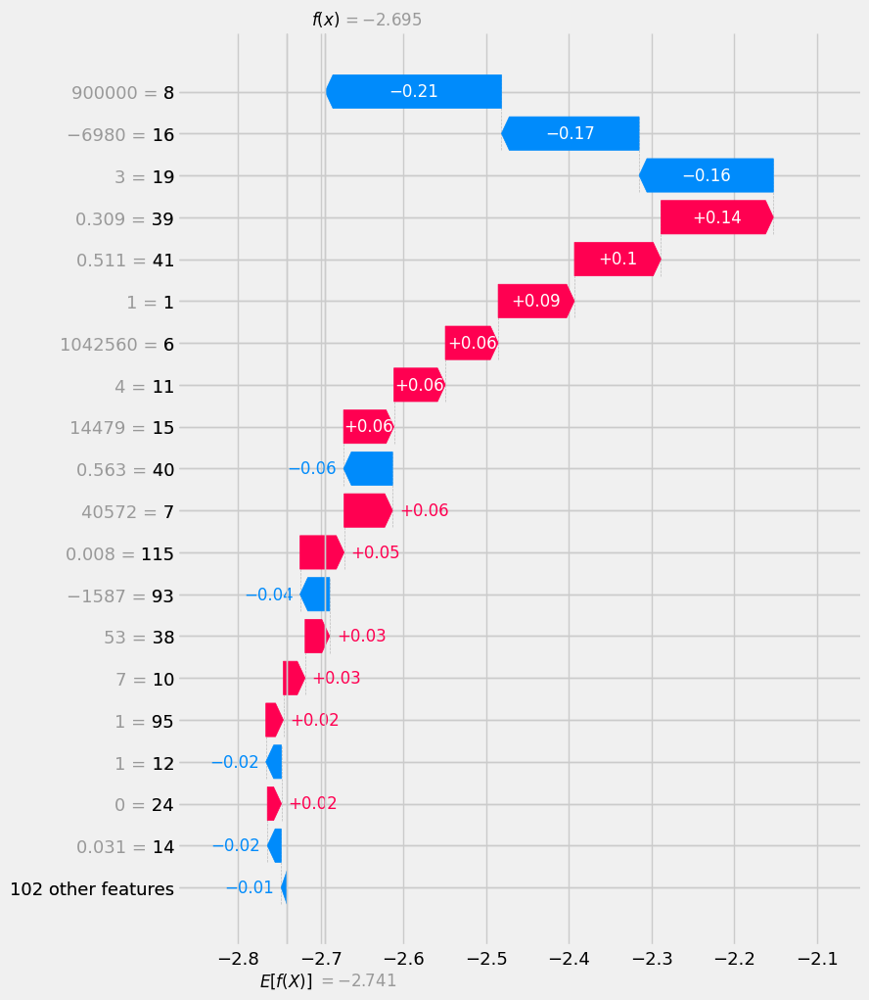

In [69]:
# Feature importance globale
shap.plots.waterfall(shap.Explanation(
    values=shap_values.values[0, ],
    base_values=shap_values.base_values[0],
    data=X_sample_shap.iloc[0]
), max_display=20) 


Feature importance locale pour le client 0


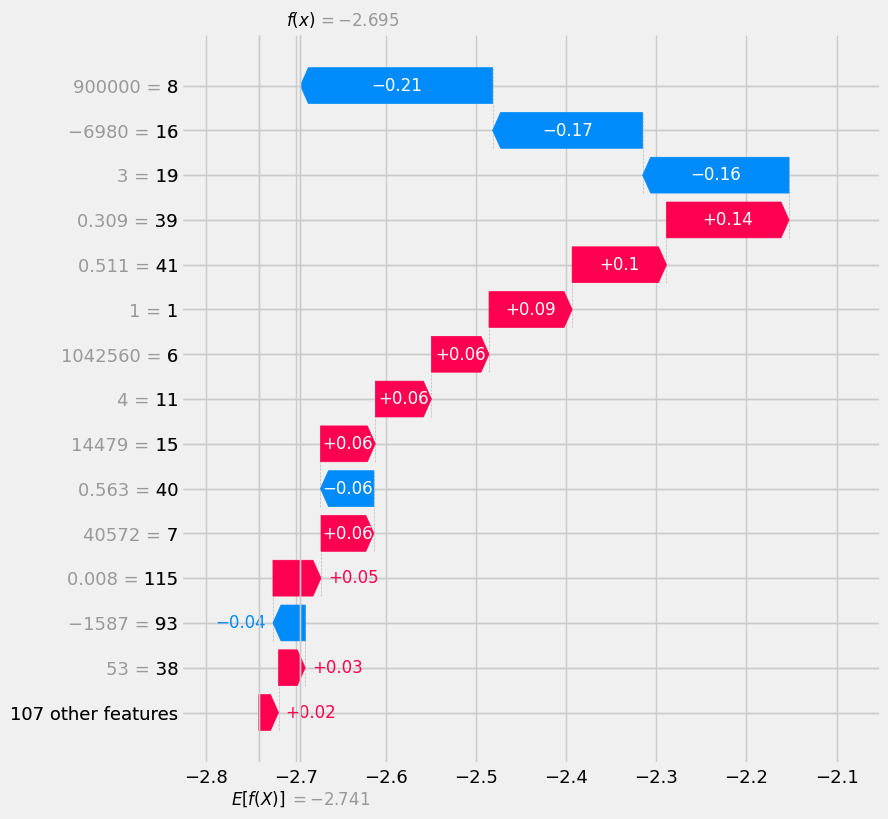


Feature importance locale pour le client 1


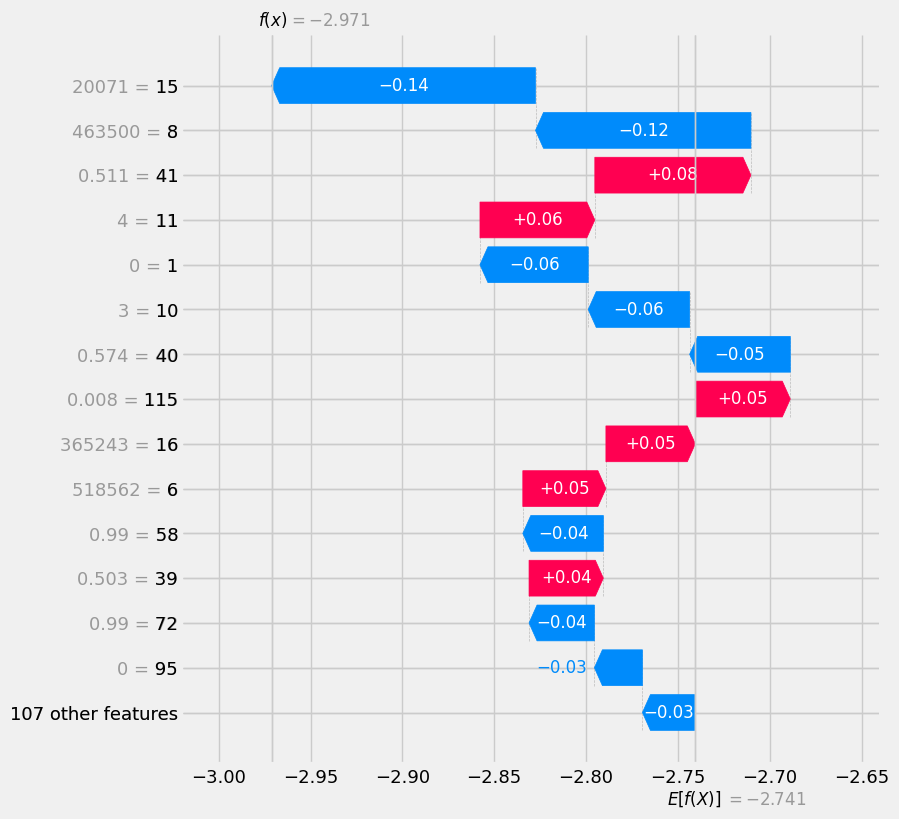


Feature importance locale pour le client 2


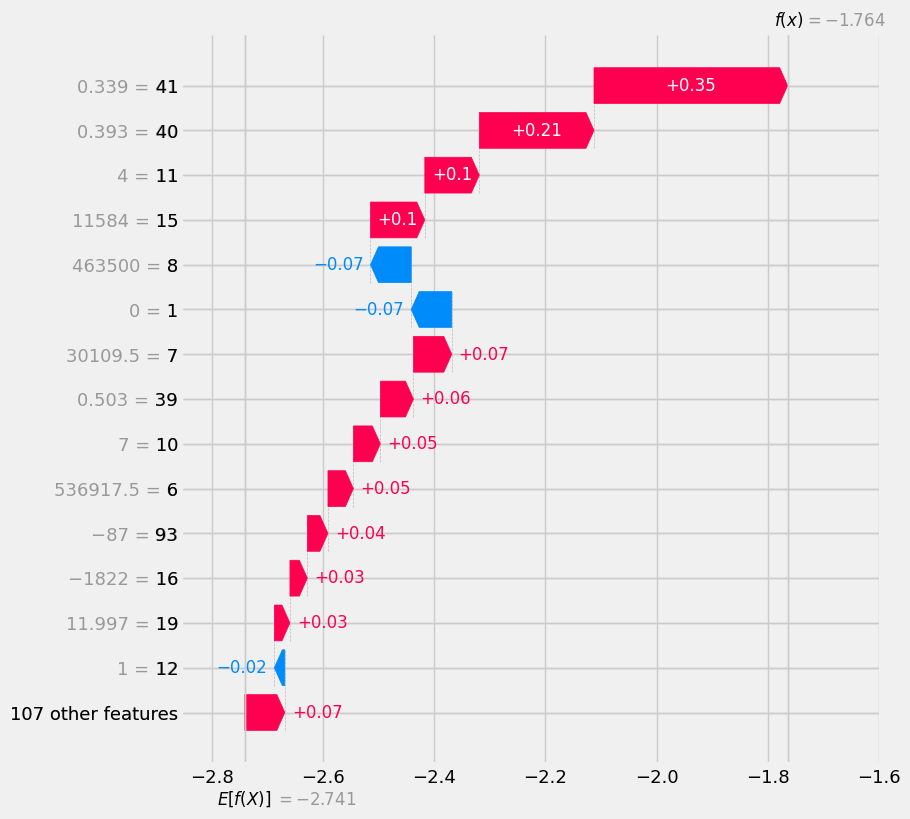

In [71]:
# Feature importance locale
for idx in [0, 1, 2]:  
    print(f"\nFeature importance locale pour le client {idx}")
    shap.plots.waterfall(shap.Explanation(
        values=shap_values.values[idx],
        base_values=shap_values.base_values[idx],
        data=X_sample_shap.iloc[idx]
    ), max_display=15)

In [ ]:
# Explain a single prediction
explainer_local = shap.KernelExplainer(loaded_model.predict_proba, X_sample_shap)
shap_values_local = explainer_local.shap_values(X_sample_shap.iloc[0, :])
shap.force_plot(explainer_local.expected_value[0], shap_values_local[:, 0], X_sample_shap.iloc[0, :])

In [ ]:
# Explain all the predictions
shap_values_local_bis = explainer_local.shap_values(X_sample_shap)
shap.force_plot(explainer_local.expected_value[0], shap_values_local_bis[..., 0], X_sample_shap)

 11%|█         | 11/100 [01:34<12:43,  8.58s/it]


KeyboardInterrupt: 

# Data drift

In [77]:
import evidently

from datetime import datetime, time
from sklearn import datasets, ensemble

from evidently import ColumnMapping
from evidently.report import Report
from evidently.metric_preset import DataDriftPreset, TargetDriftPreset, RegressionPreset

In [78]:
# Convertir la colonne SK_ID_CURR en entier
features['SK_ID_CURR'] = features['SK_ID_CURR'].astype(int)

# Afficher les premières lignes pour vérifier
print(features.head())

     0    1    2    3    4         5          6        7          8    9  ...  \
0  0.0  1.0  0.0  1.0  0.0  202500.0   406597.5  24700.5   351000.0  6.0  ...   
1  0.0  0.0  0.0  0.0  0.0  270000.0  1293502.5  35698.5  1129500.0  1.0  ...   
2  1.0  1.0  1.0  1.0  0.0   67500.0   135000.0   6750.0   135000.0  6.0  ...   
3  0.0  0.0  0.0  1.0  0.0  135000.0   312682.5  29686.5   297000.0  6.0  ...   
4  0.0  1.0  0.0  1.0  0.0  121500.0   513000.0  21865.5   513000.0  6.0  ...   

   111  112  113       114       115       116       117       118       119  \
0  0.0  0.0  0.0  0.000000  0.000000  0.000000  0.000000  0.000000  1.000000   
1  0.0  0.0  0.0  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
2  0.0  0.0  0.0  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
3  0.0  0.0  0.0  0.007097  0.007823  0.033212  0.270089  0.262452  1.881012   
4  0.0  0.0  0.0  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   

   SK_ID_CURR  
0      100002  


In [79]:
# Convertir les noms de colonnes en chaînes de caractères
features.columns = features.columns.astype(str)

# Vérifier les types de colonnes après conversion
print(features.dtypes)

0             float64
1             float64
2             float64
3             float64
4             float64
               ...   
116           float64
117           float64
118           float64
119           float64
SK_ID_CURR      int64
Length: 121, dtype: object


In [80]:
# Effectuer les prédictions
y_pred_proba = loaded_model.predict_proba(features)[:, 1]
y_pred = (y_pred_proba >= 0.5).astype(int)

# Ajouter les prédictions au DataFrame de test
features['PREDICTION'] = y_pred
features['PREDICTION_PROBA'] = y_pred_proba

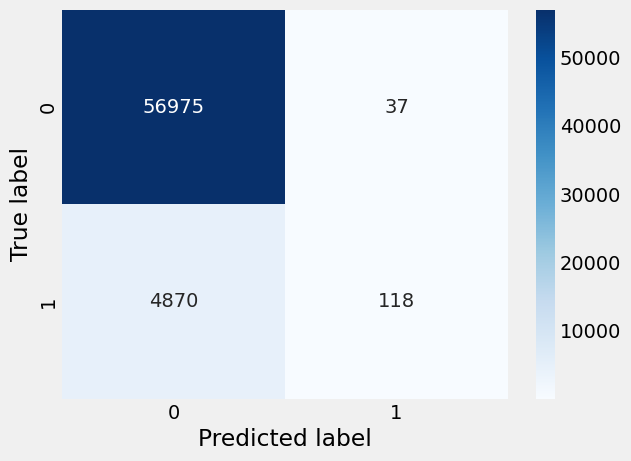

In [83]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Calculer la matrice de confusion
cm = confusion_matrix(labels, y_pred)

# Afficher la matrice de confusion
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [84]:
app_train2 = pd.read_csv('/Users/gregoirehamy/Desktop/OpenClassrooms/Projet7/Projet+Mise+en+prod+-+home-credit-default-risk/application_train.csv')

# Sélectionner uniquement la colonne 'TARGET' et 'SK_ID_CURR' de app_train
app_train_target = app_train2[['SK_ID_CURR', 'TARGET']]

# Fusionner features avec la colonne 'TARGET' de app_train
merged_df = pd.merge(features, app_train_target, on='SK_ID_CURR', how='left')

# Afficher le DataFrame fusionné
merged_df.head()

,0,1,2,3,4,5,6,7,8,9,...,114,115,116,117,118,119,SK_ID_CURR,PREDICTION,PREDICTION_PROBA,TARGET
0,0.0,1.0,0.0,1.0,0.0,202500.0,406597.5,24700.5,351000.0,6.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,100002,1,0.678448,1
1,0.0,0.0,0.0,0.0,0.0,270000.0,1293502.5,35698.5,1129500.0,1.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100003,0,0.042992,0
2,1.0,1.0,1.0,1.0,0.0,67500.0,135000.0,6750.0,135000.0,6.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100004,0,0.038049,0
3,0.0,0.0,0.0,1.0,0.0,135000.0,312682.5,29686.5,297000.0,6.0,...,0.007097,0.007823,0.033212,0.270089,0.262452,1.881012,100006,0,0.073585,0
4,0.0,1.0,0.0,1.0,0.0,121500.0,513000.0,21865.5,513000.0,6.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100007,0,0.102655,0


In [85]:
# Définir un intervalle de dates
start_date = '2023-01-01'
end_date = '2023-02-28'

# Générer des dates aléatoires
np.random.seed(42)  # Pour la reproductibilité
random_dates = np.random.choice(pd.date_range(start_date, end_date, freq='S'), size=len(merged_df))

# Ajouter la colonne de dates aléatoires au DataFrame
merged_df['DATE'] = random_dates

# Afficher le DataFrame avec les dates aléatoires
print(merged_df.head())

     0    1    2    3    4         5          6        7          8    9  ...  \
0  0.0  1.0  0.0  1.0  0.0  202500.0   406597.5  24700.5   351000.0  6.0  ...   
1  0.0  0.0  0.0  0.0  0.0  270000.0  1293502.5  35698.5  1129500.0  1.0  ...   
2  1.0  1.0  1.0  1.0  0.0   67500.0   135000.0   6750.0   135000.0  6.0  ...   
3  0.0  0.0  0.0  1.0  0.0  135000.0   312682.5  29686.5   297000.0  6.0  ...   
4  0.0  1.0  0.0  1.0  0.0  121500.0   513000.0  21865.5   513000.0  6.0  ...   

        115       116       117       118       119  SK_ID_CURR  PREDICTION  \
0  0.000000  0.000000  0.000000  0.000000  1.000000      100002           1   
1  0.000000  0.000000  0.000000  0.000000  0.000000      100003           0   
2  0.000000  0.000000  0.000000  0.000000  0.000000      100004           0   
3  0.007823  0.033212  0.270089  0.262452  1.881012      100006           0   
4  0.000000  0.000000  0.000000  0.000000  0.000000      100007           0   

   PREDICTION_PROBA  TARGET           

In [86]:
target = 'TARGET'
prediction = 'PREDICTION'
# Colonnes à exclure
exclude_columns = ['TARGET', 'PREDICTION', 'PREDICTION_PROBA', 'SK_ID_CURR', 'DATE']
# Définir numerical_features en excluant les colonnes spécifiées
numerical_features = [col for col in merged_df.columns if col not in exclude_columns]

In [87]:
column_mapping = ColumnMapping()

column_mapping.target = target
column_mapping.prediction = prediction
column_mapping.numerical_features = numerical_features

In [88]:
# Convertir la colonne 'DATE' en type datetime
merged_df['DATE'] = pd.to_datetime(merged_df['DATE'])

# Filtrer les données pour 'reference' et 'current'
reference = merged_df.loc[(merged_df['DATE'] >= '2023-01-01 00:00:00') & (merged_df['DATE'] <= '2023-01-28 00:00:00')]
current = merged_df.loc[(merged_df['DATE'] >= '2023-01-29 00:00:00') & (merged_df['DATE'] <= '2023-02-28 00:00:00')]

In [89]:
current

,0,1,2,3,4,5,6,7,8,9,...,115,116,117,118,119,SK_ID_CURR,PREDICTION,PREDICTION_PROBA,TARGET,DATE
1,0.0,0.0,0.0,0.0,0.0,270000.0,1293502.5,35698.5,1129500.0,1.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,100003,0,0.042992,0,2023-02-19 19:42:52
2,1.0,1.0,1.0,1.0,0.0,67500.0,135000.0,6750.0,135000.0,6.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,100004,0,0.038049,0,2023-02-27 00:28:04
6,0.0,0.0,1.0,1.0,1.0,171000.0,1560726.0,41301.0,1395000.0,6.0,...,0.000000,0.000000,1.000000,1.000000,2.000000,100009,0,0.024018,0,2023-02-16 19:34:47
8,0.0,0.0,0.0,1.0,0.0,112500.0,1019610.0,33826.5,913500.0,0.0,...,0.000000,0.000000,0.000000,0.000000,1.000000,100011,0,0.037794,0,2023-02-21 18:21:11
10,0.0,0.0,0.0,1.0,1.0,112500.0,652500.0,21177.0,652500.0,6.0,...,0.000000,0.000000,1.000000,0.000000,0.000000,100014,0,0.050635,0,2023-02-22 08:34:29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61990,0.0,0.0,0.0,0.0,0.0,247500.0,363190.5,24399.0,328500.0,6.0,...,0.000000,0.000000,1.000000,0.000000,6.000000,171894,1,0.558150,0,2023-01-29 11:36:58
61991,0.0,0.0,1.0,0.0,1.0,225000.0,450000.0,23881.5,450000.0,6.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,171895,0,0.046217,0,2023-02-10 14:37:04
61992,0.0,1.0,0.0,1.0,0.0,157500.0,382257.0,37237.5,382257.0,6.0,...,0.007823,0.033212,0.270089,0.262452,1.881012,171896,0,0.158845,1,2023-02-01 21:48:26
61993,0.0,1.0,1.0,1.0,0.0,130500.0,136512.0,6637.5,108000.0,6.0,...,0.000000,0.000000,0.000000,0.000000,3.000000,171897,0,0.471372,1,2023-02-25 17:22:56


## Performance du modèle

In [90]:
regression_perfomance = Report(metrics=[RegressionPreset()])
regression_perfomance.run(current_data=reference, reference_data=None, column_mapping=column_mapping)

In [91]:
regression_perfomance.show()

In [92]:
#regression_perfomance.save('reports/regression_performance_at_training.html')

## Semaine 1

In [93]:
# Filtrer les données pour 'current'
current_S1 = current[(current['DATE'] >= '2023-01-29 00:00:00') & (current['DATE'] <= '2023-02-07 23:00:00')]
regression_perfomance = Report(metrics=[RegressionPreset()])
regression_perfomance.run(current_data=current_S1,
                          reference_data=reference,
                          column_mapping=column_mapping)


regression_perfomance.show()

In [94]:
target_drift = Report(metrics=[TargetDriftPreset()])
target_drift.run(current_data=current_S1,
                 reference_data=reference,
                 column_mapping=column_mapping)

target_drift.show()

## Semaine 2

In [95]:
# Filtrer les données pour 'current'
current_S2 = current[(current['DATE'] >= '2023-02-07 00:00:00') & (current['DATE'] <= '2023-02-14 23:00:00')]
regression_perfomance = Report(metrics=[RegressionPreset()])
regression_perfomance.run(current_data=current_S2,
                          reference_data=reference,
                          column_mapping=column_mapping)

regression_perfomance.show()

In [96]:
target_drift = Report(metrics=[TargetDriftPreset()])
target_drift.run(current_data=current_S2,
                 reference_data=reference,
                 column_mapping=column_mapping)

target_drift.show()

## Semaine 3

In [97]:
# Filtrer les données pour 'current'
current_S3 = current[(current['DATE'] >= '2023-02-15 00:00:00') & (current['DATE'] <= '2023-02-21 23:00:00')]
regression_perfomance = Report(metrics=[RegressionPreset()])
regression_perfomance.run(current_data=current_S3,
                          reference_data=reference,
                          column_mapping=column_mapping)

regression_perfomance.show()

In [98]:
target_drift = Report(metrics=[TargetDriftPreset()])
target_drift.run(current_data=current_S3,
                 reference_data=reference,
                 column_mapping=column_mapping)

target_drift.show()

## Data drift final

In [99]:
column_mapping = ColumnMapping()

column_mapping.numerical_features = numerical_features

In [100]:
# Filtrer les données pour 'current'
current_final = current[(current['DATE'] >= '2023-01-29 00:00:00') & (current['DATE'] <= '2023-02-07 23:00:00')]
data_drift = Report(metrics = [DataDriftPreset()])
data_drift.run(current_data = current_final,
               reference_data = reference,
               column_mapping=column_mapping)

data_drift.show()

In [103]:
data_drift.save("data_drift_dashboard_after_week1.html")